In [73]:
import sys
sys.path.append('../lib')

import warnings
warnings.filterwarnings('ignore')

import numpy as np
import random
from matplotlib import pyplot as plt
from matplotlib import colors as mpc
plt.rcParams["font.family"] = "Poppins"
from sklearn.mixture import GaussianMixture
import pandas as pd
import seaborn as sns; sns.set()
from sklearn.metrics import r2_score 
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error
from gmr.utils import check_random_state
from gmr import MVN, GMM, plot_error_ellipses
random_state = check_random_state(0)

from IPython.display import clear_output
import plotly.express as px
%load_ext autoreload
%autoreload 
%matplotlib inline
from plotly import graph_objects as go
from matplotlib.dates import MonthLocator, DateFormatter
import matplotlib.dates as mdates



The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [2]:
# import data
path = "/Users/garimaraheja/Google Drive/My Drive/lcs/global-gmr/all_colocs.csv"
data = pd.read_csv(path, header = 0, index_col = 0)
data.reset_index(inplace=True, drop=True)
data['index'] = np.arange(0, len(data))
data.set_index('index',inplace=True)
data

,Unnamed: 0.1,Unnamed: 0.1.1,Timestamp (UTC),Site Code,Site Code_B,LCS Type,REF Type,LCS PM2.5 Channel A [ug/m3],LCS PM2.5 Channel B [ug/m3],LCS Avg_Temperature [oC],...,LCS PM2.5 Channel C [ug/m3],LCS Pressure [kPa],Status,LCS Dewpoint [oC],purpleair_pm2.5,LCS Min_Temperature [oC],LCS Max_Temperature [oC],LCS PM2.5 Channel AB Average [ug/m3],Conc (mg/m3),REF Avg_Temperature [oC]
index,,,,,,,,,,,,,,,,,,,,,
0,0,2663,2018-03-30 00:00:00+00:00,PIT,LAW,PA,BAM,0.717111,0.832055,11.896670,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.774583,NaN,NaN
1,1,2664,2018-03-30 01:00:00+00:00,PIT,LAW,PA,BAM,0.485429,0.640574,10.844692,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.563002,NaN,NaN
2,2,2666,2018-03-30 03:00:00+00:00,PIT,LAW,PA,BAM,2.055419,2.117477,9.352512,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.086448,NaN,NaN
3,3,2667,2018-03-30 04:00:00+00:00,PIT,LAW,PA,BAM,2.805089,2.675947,9.294935,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.740518,NaN,NaN
4,4,2668,2018-03-30 05:00:00+00:00,PIT,LAW,PA,BAM,2.239654,2.322421,8.843633,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.281037,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
157806,157806,6646,2024-01-13 05:00:00+00:00,vand,NaN,AG,AG_REF?,53.514930,NaN,25.432281,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,53.514930,NaN,NaN
157807,157807,6647,2024-01-13 06:00:00+00:00,vand,NaN,AG,AG_REF?,39.968866,NaN,29.946065,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,39.968866,NaN,NaN
157808,157808,6648,2024-01-13 07:00:00+00:00,vand,NaN,AG,AG_REF?,37.767582,NaN,34.137963,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,37.767582,NaN,NaN


In [3]:
data['Site Code'].unique()

array(['PIT', 'QNR', 'anac', 'ORL', 'CMB', 'LCPH', 'chen', 'ucam', 'POLK',
       'PAL', 'UGH', 'LKSG', 'CMH', 'CCU', 'ACC', 'USA', 'NYC', 'bell',
       'NCOR', 'NBO', 'vand'], dtype=object)

In [4]:
site_code_map = {'PIT':0, 'QNR':1, 'anac':2, 'ORL':3, 'CMB':4, 'LCPH':5, 'chen':6, 'ucam':7, 'POLK':8,
       'PAL':9, 'UGH':10, 'LKSG':11, 'CMH':12, 'CCU':13, 'ACC':14, 'USA':15, 'NYC':16, 'bell':17,
       'NCOR':18, 'NBO':19, 'vand':20}
data['Site#'] = data['Site Code'].map(site_code_map)
data

,Unnamed: 0.1,Unnamed: 0.1.1,Timestamp (UTC),Site Code,Site Code_B,LCS Type,REF Type,LCS PM2.5 Channel A [ug/m3],LCS PM2.5 Channel B [ug/m3],LCS Avg_Temperature [oC],...,LCS Pressure [kPa],Status,LCS Dewpoint [oC],purpleair_pm2.5,LCS Min_Temperature [oC],LCS Max_Temperature [oC],LCS PM2.5 Channel AB Average [ug/m3],Conc (mg/m3),REF Avg_Temperature [oC],Site#
index,,,,,,,,,,,,,,,,,,,,,
0,0,2663,2018-03-30 00:00:00+00:00,PIT,LAW,PA,BAM,0.717111,0.832055,11.896670,...,NaN,NaN,NaN,NaN,NaN,NaN,0.774583,NaN,NaN,0
1,1,2664,2018-03-30 01:00:00+00:00,PIT,LAW,PA,BAM,0.485429,0.640574,10.844692,...,NaN,NaN,NaN,NaN,NaN,NaN,0.563002,NaN,NaN,0
2,2,2666,2018-03-30 03:00:00+00:00,PIT,LAW,PA,BAM,2.055419,2.117477,9.352512,...,NaN,NaN,NaN,NaN,NaN,NaN,2.086448,NaN,NaN,0
3,3,2667,2018-03-30 04:00:00+00:00,PIT,LAW,PA,BAM,2.805089,2.675947,9.294935,...,NaN,NaN,NaN,NaN,NaN,NaN,2.740518,NaN,NaN,0
4,4,2668,2018-03-30 05:00:00+00:00,PIT,LAW,PA,BAM,2.239654,2.322421,8.843633,...,NaN,NaN,NaN,NaN,NaN,NaN,2.281037,NaN,NaN,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
157806,157806,6646,2024-01-13 05:00:00+00:00,vand,NaN,AG,AG_REF?,53.514930,NaN,25.432281,...,NaN,NaN,NaN,NaN,NaN,NaN,53.514930,NaN,NaN,20
157807,157807,6647,2024-01-13 06:00:00+00:00,vand,NaN,AG,AG_REF?,39.968866,NaN,29.946065,...,NaN,NaN,NaN,NaN,NaN,NaN,39.968866,NaN,NaN,20
157808,157808,6648,2024-01-13 07:00:00+00:00,vand,NaN,AG,AG_REF?,37.767582,NaN,34.137963,...,NaN,NaN,NaN,NaN,NaN,NaN,37.767582,NaN,NaN,20


In [5]:
# subset just to get columns for model
model_data = data[["LCS PM2.5 Channel AB Average [ug/m3]", "LCS Avg_Temperature [oC]", "LCS Relative Humidity [%]", "REF PM2.5 [ug/m3]"]]
model_data.dropna(how='any',inplace=True)
model_data

,LCS PM2.5 Channel AB Average [ug/m3],LCS Avg_Temperature [oC],LCS Relative Humidity [%],REF PM2.5 [ug/m3]
index,,,,
0,0.774583,11.896670,75.748239,4.000
1,0.563002,10.844692,75.156751,1.000
2,2.086448,9.352512,76.047200,1.000
3,2.740518,9.294935,75.750000,3.000
4,2.281037,8.843633,77.340736,2.000
...,...,...,...,...
157806,53.514930,25.432281,47.997201,31.100
157807,39.968866,29.946065,37.775000,19.393
157808,37.767582,34.137963,29.373758,17.142


In [6]:
data['Site Code'].unique()

array(['PIT', 'QNR', 'anac', 'ORL', 'CMB', 'LCPH', 'chen', 'ucam', 'POLK',
       'PAL', 'UGH', 'LKSG', 'CMH', 'CCU', 'ACC', 'USA', 'NYC', 'bell',
       'NCOR', 'NBO', 'vand'], dtype=object)

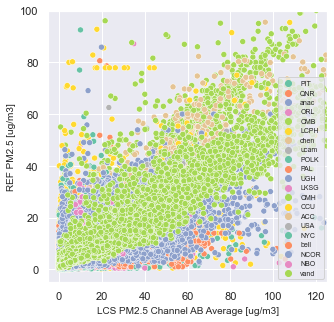

In [7]:
fig, ax = plt.subplots(figsize=(5,5))
sns.scatterplot(data=data, x='LCS PM2.5 Channel AB Average [ug/m3]', y='REF PM2.5 [ug/m3]',hue='Site Code',palette='Set2')
ax.set_xlim(-5, 125)
ax.set_ylim(-5,100)
plt.legend(loc='lower right', fontsize = 7)
fig.show()

In [8]:
fig = px.scatter(data, x="LCS PM2.5 Channel AB Average [ug/m3]", y="REF PM2.5 [ug/m3]", color="Site Code",color_discrete_sequence=px.colors.qualitative.Dark24)
fig.update_layout(
    autosize=False,
    width=700,
    height=700,
)
fig.update_layout(yaxis_range=[-5,125])
fig.update_layout(xaxis_range=[-5,125])
fig.show()

In [9]:
fig = px.scatter(data, x="LCS PM2.5 Channel AB Average [ug/m3]", y="REF PM2.5 [ug/m3]", color="LCS Type",color_discrete_sequence=px.colors.qualitative.Bold)
fig.update_layout(
    autosize=False,
    width=700,
    height=700,
)
fig.update_layout(yaxis_range=[-5,125])
fig.update_layout(xaxis_range=[-5,125])
fig.show()

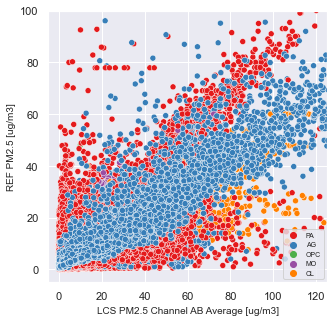

In [10]:
fig, ax = plt.subplots(figsize=(5,5))
sns.scatterplot(data=data, x='LCS PM2.5 Channel AB Average [ug/m3]', y='REF PM2.5 [ug/m3]',hue='LCS Type',palette='Set1')
ax.set_xlim(-5, 125)
ax.set_ylim(-5,100)
plt.legend(loc='lower right', fontsize = 7)
fig.show()

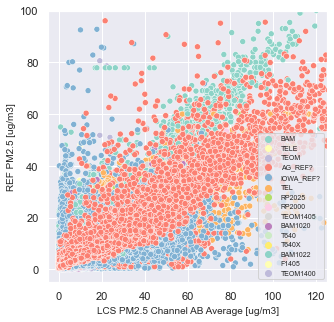

In [11]:
fig, ax = plt.subplots(figsize=(5,5))
sns.scatterplot(data=data, x='LCS PM2.5 Channel AB Average [ug/m3]', y='REF PM2.5 [ug/m3]',hue='REF Type',palette='Set3')
ax.set_xlim(-5, 125)
ax.set_ylim(-5,100)
plt.legend(loc='lower right', fontsize = 7)
fig.show()

In [12]:
train_, test_ = train_test_split(model_data, test_size = 0.2, random_state = 13)

gmm = GMM(n_components = 25, random_state = 11)
gmm.from_samples(train_.to_numpy())

Y = gmm.predict(np.array([0,1,2]), test_[["LCS PM2.5 Channel AB Average [ug/m3]", "LCS Avg_Temperature [oC]", "LCS Relative Humidity [%]"]].to_numpy())

print(r2_score(Y, test_[["REF PM2.5 [ug/m3]"]].to_numpy()))
print(mean_absolute_error(Y, test_[["REF PM2.5 [ug/m3]"]].to_numpy()))

0.6937584247998312
2.887987905401983


In [13]:
# select models with lowest R2
n_components = np.arange(1, 25,4)
models_train = [GMM(n, random_state = 11).from_samples(train_.to_numpy()) for n in n_components]

sns.set_style("ticks", {"xtick.major.size": 7, "ytick.major.size": 7})



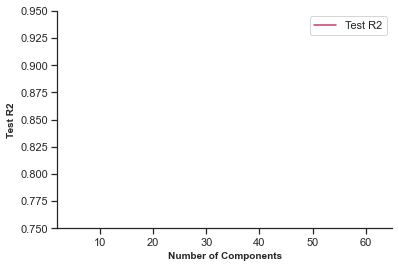

In [14]:
#R2
plt.figure()
plt.plot(n_components, [r2_score(m.predict(np.array([0,1,2]), test_[["LCS PM2.5 Channel AB Average [ug/m3]", "LCS Avg_Temperature [oC]", "LCS Relative Humidity [%]"]].to_numpy()), test_[["REF PM2.5 [ug/m3]"]].to_numpy())
 for m in models_train], color = "#C33969", label = 'Test R2')
plt.legend(loc = 'upper right')
plt.xlabel('Number of Components', fontweight = 'bold')
plt.ylabel('Test R2', fontweight = 'bold')

sns.despine()
plt.xlim(2,65)
plt.ylim(0.75,0.95)
plt.show()


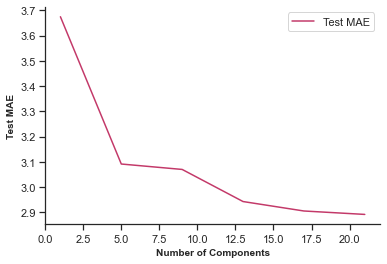

In [15]:
#MAE
plt.figure()
plt.plot(n_components, [mean_absolute_error(m.predict(np.array([0,1,2]), test_[["LCS PM2.5 Channel AB Average [ug/m3]", "LCS Avg_Temperature [oC]", "LCS Relative Humidity [%]"]].to_numpy()), test_[["REF PM2.5 [ug/m3]"]].to_numpy())
 for m in models_train], color = "#C33969", label = 'Test MAE')
plt.legend(loc = 'upper right')
plt.xlabel('Number of Components', fontweight = 'bold')
plt.ylabel('Test MAE', fontweight = 'bold')

sns.despine()

plt.show()

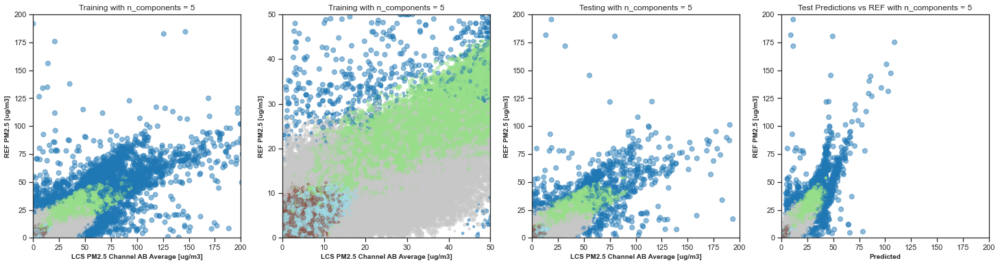

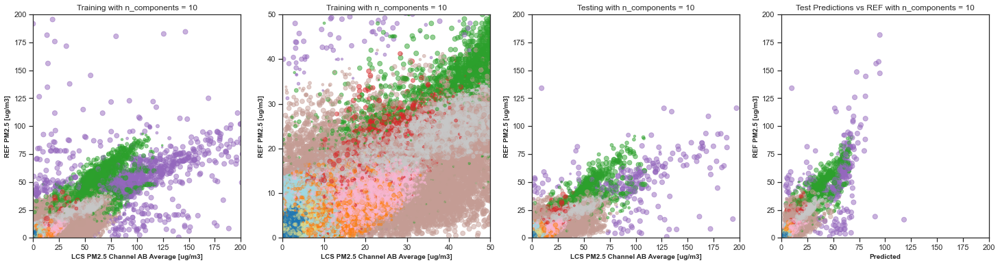

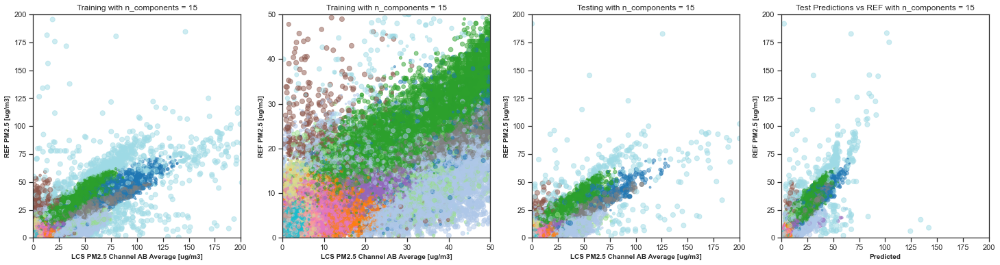

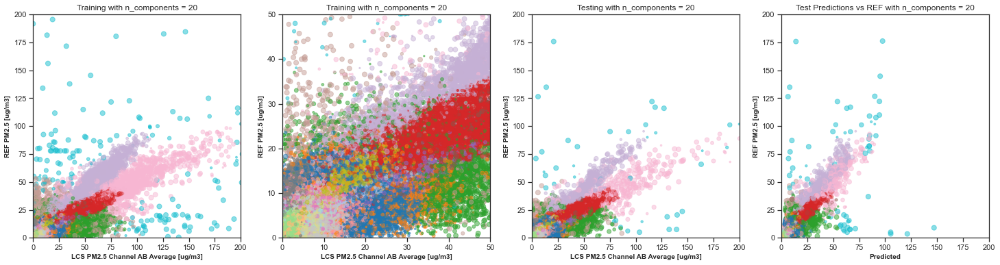

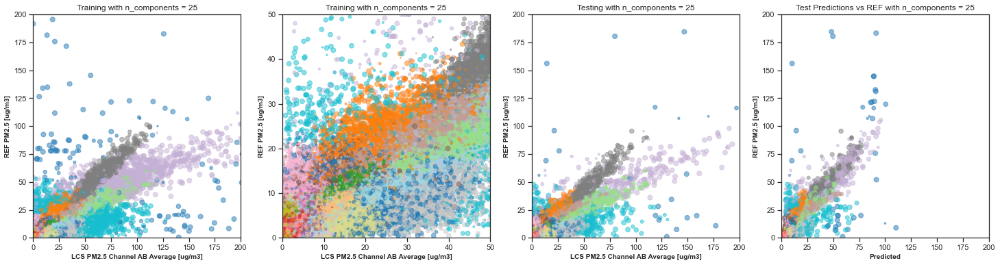

In [16]:
sns.set_style("ticks", {"xtick.major.size": 7, "ytick.major.size": 7})
scores = pd.DataFrame(columns=['Components','R2','MAE'])

for n_comp in np.arange(2,30):
    if n_comp%5==0:

        train_, test_ = train_test_split(model_data, test_size = 0.2)

        gmm = GMM(n_components = n_comp)
        gmm.from_samples(train_.to_numpy())

        Y = gmm.predict(np.array([0,1,2]), test_[["LCS PM2.5 Channel AB Average [ug/m3]", "LCS Avg_Temperature [oC]", "LCS Relative Humidity [%]"]].to_numpy())



        r2 = r2_score(Y, test_[["REF PM2.5 [ug/m3]"]].to_numpy())
        mae = mean_absolute_error(Y, test_[["REF PM2.5 [ug/m3]"]].to_numpy())

        scores.loc[len(scores.index)] = [n_comp, r2, mae ] 

        #get array of resposnsibilities
        probs = gmm.to_responsibilities(train_)
        labels = np.argmax(probs, axis=1)
        size = 50 * probs.max(1) ** 3
    
        if n_comp % 5 ==0:
            
            fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(25, 6))
    
            ax1.scatter(train_[['LCS PM2.5 Channel AB Average [ug/m3]']].values, train_[['REF PM2.5 [ug/m3]']].values, c = labels, cmap='tab20', s = size, alpha = 0.5)
            ax1.set_xlabel('LCS PM2.5 Channel AB Average [ug/m3]', fontweight = 'bold')
            ax1.set_ylabel('REF PM2.5 [ug/m3]', fontweight = 'bold')
            ax1.title.set_text('Training with n_components = ' + str(n_comp))
            ax1.set_xlim([0, 200])
            ax1.set_ylim([0, 200])

            ax2.scatter(train_[['LCS PM2.5 Channel AB Average [ug/m3]']].values, train_[['REF PM2.5 [ug/m3]']].values, c = labels, cmap='tab20', s = size, alpha = 0.5)
            ax2.set_xlabel('LCS PM2.5 Channel AB Average [ug/m3]', fontweight = 'bold')
            ax2.set_ylabel('REF PM2.5 [ug/m3]', fontweight = 'bold')
            ax2.title.set_text('Training with n_components = ' + str(n_comp))
            ax2.set_xlim([0, 50])
            ax2.set_ylim([0, 50])
    
            #get array of resposnsibilities
            probs = gmm.to_responsibilities(test_)
            labels=[]
            labels = np.argmax(probs, axis=1)
            size = 50 * probs.max(1) ** 3
    
            ax3.scatter(test_[['LCS PM2.5 Channel AB Average [ug/m3]']].values, test_[['REF PM2.5 [ug/m3]']].values, c = labels, cmap='tab20',s = size, alpha = 0.5)
            ax3.set_xlabel('LCS PM2.5 Channel AB Average [ug/m3]', fontweight = 'bold')
            ax3.set_ylabel('REF PM2.5 [ug/m3]', fontweight = 'bold')
            ax3.title.set_text('Testing with n_components = ' + str( n_comp))
            ax3.set_xlim([0, 200])
            ax3.set_ylim([0, 200])
    
            ax4.scatter(Y, test_[['REF PM2.5 [ug/m3]']].values, c = labels, cmap='tab20', s = size, alpha = 0.5)
            ax4.set_xlabel('Predicted', fontweight = 'bold')
            ax4.set_ylabel('REF PM2.5 [ug/m3]', fontweight = 'bold')
            ax4.title.set_text('Test Predictions vs REF with n_components = ' + str( n_comp))
            ax4.set_xlim([0, 200])
            ax4.set_ylim([0, 200])

            plt.show();

            test_sites = test_.merge(data, left_on=test_.index, right_on=data.index)
            test_sites['labels'] = labels
            test_sites = test_sites.groupby(['Site#', 'labels']).count().reset_index()
            test_sites['distrib'] = np.round(test_sites['key_0']/len(test_sites),1)/100
            table = test_sites.pivot(index='Site#', columns='labels', values='distrib')
            fig = px.imshow(table, text_auto='.1%',color_continuous_scale='purp')
            fig.update_layout(
                autosize=False,
                width=900,
                height=700,
            )
            
            fig.update_layout(
                xaxis = dict(
                    tickmode = 'linear',
                    tick0 = 0,
                    dtick = 1
                )
            )
            
            fig.update_layout(
                yaxis = dict(
                    tickmode = 'linear',
                    tick0 = 0,
                    dtick = 1
                )
            )
            
            
            fig.show()
    
# plt.figure()
# plt.plot(scores['Components'],scores['R2'])
# plt.xlabel('Components')
# plt.ylabel('R2')
# plt.title('R2')
# plt.show()


# plt.figure()
# plt.xlabel('Components')
# plt.ylabel('MAE')
# plt.plot(scores['Components'],scores['MAE'])
# plt.title('MAE')
# plt.show()


# check component lineup - classify and compare with cities

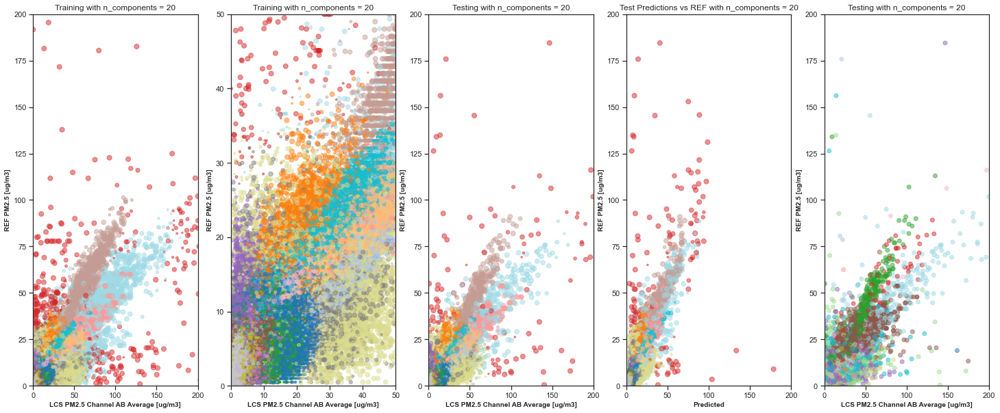

In [17]:
sns.set_style("ticks", {"xtick.major.size": 7, "ytick.major.size": 7})
scores = pd.DataFrame(columns=['Components','R2','MAE'])

for n_comp in np.arange(20,22):
    if True:

        train_, test_ = train_test_split(model_data, test_size = 0.2)

        gmm = GMM(n_components = n_comp)
        gmm.from_samples(train_.to_numpy())

        Y = gmm.predict(np.array([0,1,2]), test_[["LCS PM2.5 Channel AB Average [ug/m3]", "LCS Avg_Temperature [oC]", "LCS Relative Humidity [%]"]].to_numpy())



        r2 = r2_score(Y, test_[["REF PM2.5 [ug/m3]"]].to_numpy())
        mae = mean_absolute_error(Y, test_[["REF PM2.5 [ug/m3]"]].to_numpy())

        scores.loc[len(scores.index)] = [n_comp, r2, mae ] 

        #get array of resposnsibilities
        probs = gmm.to_responsibilities(train_)
        labels = np.argmax(probs, axis=1)
        size = 50 * probs.max(1) ** 3
    
        if n_comp % 5 ==0:
            
            fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1, 5, figsize=(25, 10))
    
            ax1.scatter(train_[['LCS PM2.5 Channel AB Average [ug/m3]']].values, train_[['REF PM2.5 [ug/m3]']].values, c = labels, cmap='tab20', s = size, alpha = 0.5)
            ax1.set_xlabel('LCS PM2.5 Channel AB Average [ug/m3]', fontweight = 'bold')
            ax1.set_ylabel('REF PM2.5 [ug/m3]', fontweight = 'bold')
            ax1.title.set_text('Training with n_components = ' + str(n_comp))
            ax1.set_xlim([0, 200])
            ax1.set_ylim([0, 200])

            ax2.scatter(train_[['LCS PM2.5 Channel AB Average [ug/m3]']].values, train_[['REF PM2.5 [ug/m3]']].values, c = labels, cmap='tab20', s = size, alpha = 0.5)
            ax2.set_xlabel('LCS PM2.5 Channel AB Average [ug/m3]', fontweight = 'bold')
            ax2.set_ylabel('REF PM2.5 [ug/m3]', fontweight = 'bold')
            ax2.title.set_text('Training with n_components = ' + str(n_comp))
            ax2.set_xlim([0, 50])
            ax2.set_ylim([0, 50])
    
            #get array of resposnsibilities
            probs = gmm.to_responsibilities(test_)
            labels=[]
            labels = np.argmax(probs, axis=1)
            size = 50 * probs.max(1) ** 3
    
            ax3.scatter(test_[['LCS PM2.5 Channel AB Average [ug/m3]']].values, test_[['REF PM2.5 [ug/m3]']].values, c = labels, cmap='tab20',s = size, alpha = 0.5)
            ax3.set_xlabel('LCS PM2.5 Channel AB Average [ug/m3]', fontweight = 'bold')
            ax3.set_ylabel('REF PM2.5 [ug/m3]', fontweight = 'bold')
            ax3.title.set_text('Testing with n_components = ' + str( n_comp))
            ax3.set_xlim([0, 200])
            ax3.set_ylim([0, 200])
    
            ax4.scatter(Y, test_[['REF PM2.5 [ug/m3]']].values, c = labels, cmap='tab20', s = size, alpha = 0.5)
            ax4.set_xlabel('Predicted', fontweight = 'bold')
            ax4.set_ylabel('REF PM2.5 [ug/m3]', fontweight = 'bold')
            ax4.title.set_text('Test Predictions vs REF with n_components = ' + str( n_comp))
            ax4.set_xlim([0, 200])
            ax4.set_ylim([0, 200])

            

            

   

            test_sites = test_.merge(data, left_on=test_.index, right_on=data.index)
            test_sites['labels'] = labels
            ts = test_sites.groupby(['Site#', 'labels']).count().reset_index()
            ts['distrib'] = np.round(ts['key_0']/len(ts),1)/100
            table = ts.pivot(index='Site#', columns='labels', values='distrib')


            ax5.scatter(test_sites[['LCS PM2.5 Channel AB Average [ug/m3]_x']].values, test_sites[['REF PM2.5 [ug/m3]_x']].values, c = test_sites[['Site#']].values, cmap='tab20', alpha = 0.5)
            ax5.set_xlabel('LCS PM2.5 Channel AB Average [ug/m3]', fontweight = 'bold')
            ax5.set_ylabel('REF PM2.5 [ug/m3]', fontweight = 'bold')
            ax5.title.set_text('Testing with n_components = ' + str( n_comp))
            ax5.set_xlim([0, 200])
            ax5.set_ylim([0, 200])

            
            fig = px.imshow(table, text_auto='.1%',color_continuous_scale='purp')
            fig.update_layout(
                autosize=False,
                width=900,
                height=700,
            )
            
            fig.update_layout(
                xaxis = dict(
                    tickmode = 'linear',
                    tick0 = 0,
                    dtick = 1
                )
            )
            
            fig.update_layout(
                yaxis = dict(
                    tickmode = 'linear',
                    tick0 = 0,
                    dtick = 1
                )
            )
            
            
            fig.show()
    
# plt.figure()
# plt.plot(scores['Components'],scores['R2'])
# plt.xlabel('Components')
# plt.ylabel('R2')
# plt.title('R2')
# plt.show()


# plt.figure()
# plt.xlabel('Components')
# plt.ylabel('MAE')
# plt.plot(scores['Components'],scores['MAE'])
# plt.title('MAE')
# plt.show()


# check component lineup - classify and compare with cities

# component and city lineup is not just 1:1 -- means that some cities are in diff components

#todo: normalize by row
#todo: label xaxis as component

#don't just use one site on another, use a gmr instead (combine green graph vs purple)

#measure noise in the data - for each site, get its R2/MAE

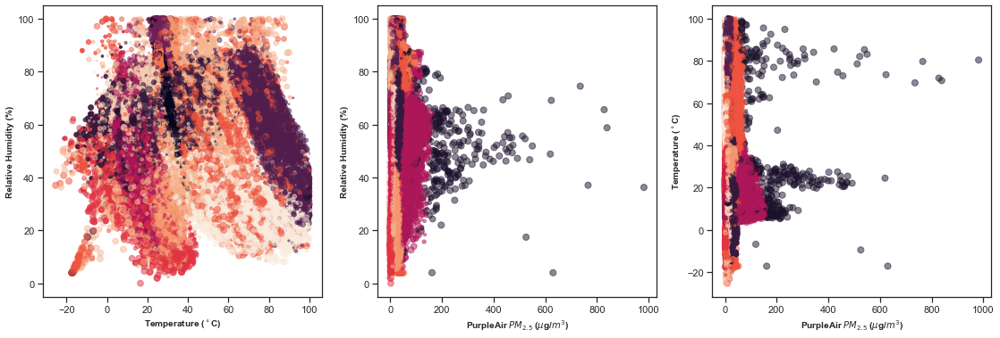

In [18]:
train_, test_ = train_test_split(model_data, test_size = 0.2)

gmm = GMM(n_components = 15)
gmm.from_samples(train_.to_numpy())

Y = gmm.predict(np.array([0,1,2]), test_[["LCS PM2.5 Channel AB Average [ug/m3]", "LCS Avg_Temperature [oC]", "LCS Relative Humidity [%]"]].to_numpy())
r2 = r2_score(Y, test_[["REF PM2.5 [ug/m3]"]].to_numpy())
mae = mean_absolute_error(Y, test_[["REF PM2.5 [ug/m3]"]].to_numpy())

#scores.loc[len(scores.index)] = [n_comp, r2, mae ] 

#get array of resposnsibilities
probs = gmm.to_responsibilities(model_data)
labels = np.argmax(probs, axis=1)
size = 50 * probs.max(1) ** 3


fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(19, 6))

ax1.scatter(model_data[['LCS Avg_Temperature [oC]']], model_data[['LCS Relative Humidity [%]']], c = labels, s = size, alpha = 0.5)
ax1.set_xlabel('Temperature ($^\circ$C)', fontweight = 'bold')
ax1.set_ylabel('Relative Humidity (%)', fontweight = 'bold')

ax2.scatter(model_data[['LCS PM2.5 Channel AB Average [ug/m3]']], model_data[['LCS Relative Humidity [%]']], c = labels, s = size, alpha = 0.5)
ax2.set_xlabel('PurpleAir $PM_{2.5}$ ($\mu$g/$m^3$)', fontweight = 'bold')
ax2.set_ylabel('Relative Humidity (%)', fontweight = 'bold')

ax3.scatter(model_data[['LCS PM2.5 Channel AB Average [ug/m3]']], model_data[['LCS Avg_Temperature [oC]']], c = labels, s = size, alpha = 0.5)
ax3.set_xlabel('PurpleAir $PM_{2.5}$ ($\mu$g/$m^3$)', fontweight = 'bold')
ax3.set_ylabel('Temperature ($^\circ$C)', fontweight = 'bold')

plt.show();


In [19]:
model_data_2 = model_data
model_data_2['labels'] = labels
model_data_2 = model_data_2[model_data_2['LCS PM2.5 Channel AB Average [ug/m3]']<100]

df = px.data.iris()
fig = px.scatter_3d(model_data_2, x='LCS PM2.5 Channel AB Average [ug/m3]', y='LCS Avg_Temperature [oC]', z='LCS Relative Humidity [%]',
              color=model_data_2['labels'])
fig.show()

In [13]:
# import data
path = "/Users/garimaraheja/Google Drive/My Drive/lcs/global-gmr/all_colocs.csv"
data = pd.read_csv(path, header = 0, index_col = 0)

# subset just to get columns for model
model_data = data[["LCS PM2.5 Channel AB Average [ug/m3]", "LCS Avg_Temperature [oC]", "LCS Relative Humidity [%]", "REF PM2.5 [ug/m3]"]]
model_data.dropna(how='any',inplace=True)
model_data


,LCS PM2.5 Channel AB Average [ug/m3],LCS Avg_Temperature [oC],LCS Relative Humidity [%],REF PM2.5 [ug/m3]
0,0.774583,11.896670,75.748239,4.000
1,0.563002,10.844692,75.156751,1.000
2,2.086448,9.352512,76.047200,1.000
3,2.740518,9.294935,75.750000,3.000
4,2.281037,8.843633,77.340736,2.000
...,...,...,...,...
157806,53.514930,25.432281,47.997201,31.100
157807,39.968866,29.946065,37.775000,19.393
157808,37.767582,34.137963,29.373758,17.142
157809,30.450521,34.413773,28.160069,15.043


In [14]:
# WITH TRAIN TEST SPLIT
local_global_scores = pd.DataFrame(columns=['Components','Leavout','Test City','Global Trained R2','Global Trained MAE','Local Trained R2','Local Trained MAE'])
global_gmr_scores = pd.DataFrame(columns=['Components','Leavout','R2','MAE'])

for num_components in np.arange(7,8):
    print('num components: ', num_components)
    for leavout_code in data['Site Code'].unique(): # testing out leaving one city out at a time

        #print('Leaving Out ', leavout_code, ' from Global GMR')
        without_city = data[data['Site Code'] != leavout_code]
        

        without_city = without_city[["LCS PM2.5 Channel AB Average [ug/m3]", "LCS Avg_Temperature [oC]", "LCS Relative Humidity [%]","REF PM2.5 [ug/m3]","Site Code"]]
        without_city.dropna(how='any',inplace=True)
        
        train_, test_ = train_test_split(without_city, test_size = 0.2)

        global_gmm = GMM(n_components = num_components)
        global_gmm.from_samples(train_[["LCS PM2.5 Channel AB Average [ug/m3]", "LCS Avg_Temperature [oC]", "LCS Relative Humidity [%]","REF PM2.5 [ug/m3]"]].to_numpy())
        
        Y_global = global_gmm.predict(np.array([0,1,2]), test_[["LCS PM2.5 Channel AB Average [ug/m3]", "LCS Avg_Temperature [oC]", "LCS Relative Humidity [%]"]].to_numpy())


        #print('Global GMR Scores - Testing')
        global_gmr_r2_score = r2_score(Y_global, test_[["REF PM2.5 [ug/m3]"]].to_numpy())
        global_gmr_mae_score = mean_absolute_error(Y_global, test_[["REF PM2.5 [ug/m3]"]].to_numpy())
 
        global_gmr_scores.loc[len(global_gmr_scores.index)] = [num_components,leavout_code,global_gmr_r2_score,global_gmr_mae_score] 


        for site_code in without_city['Site Code'].unique():
            #print('   Site: ', site_code)

            subset_data = without_city[without_city['Site Code'] == site_code]
            subset_data = subset_data[["LCS PM2.5 Channel AB Average [ug/m3]", "LCS Avg_Temperature [oC]", "LCS Relative Humidity [%]","REF PM2.5 [ug/m3]"]]
            subset_data.dropna(how='any',inplace=True)
            
            local_train_, local_test_ = train_test_split(subset_data, test_size = 0.2)

            # predict using global model
            Y_global_pred_subset = global_gmm.predict(np.array([0,1,2]), local_test_[["LCS PM2.5 Channel AB Average [ug/m3]", "LCS Avg_Temperature [oC]", "LCS Relative Humidity [%]"]].to_numpy())



            #print('   Scores Using Global Model')
            global_r2 = r2_score(Y_global_pred_subset, local_test_[["REF PM2.5 [ug/m3]"]].to_numpy())
            global_mae = mean_absolute_error(Y_global_pred_subset, local_test_[["REF PM2.5 [ug/m3]"]].to_numpy())
            #print('   R2: ', global_r2)
            #print('   MAE: ', global_mae)


            # train local model
            local_gmm = GMM(n_components = num_components)
            local_gmm.from_samples(local_train_.to_numpy())

            # predict using local model
            Y_local_pred_subset = local_gmm.predict(np.array([0,1,2]), local_test_[["LCS PM2.5 Channel AB Average [ug/m3]", "LCS Avg_Temperature [oC]", "LCS Relative Humidity [%]"]].to_numpy())


            #print('   Scores Using Local Model')
            local_r2 = r2_score(Y_local_pred_subset, local_test_[["REF PM2.5 [ug/m3]"]].to_numpy())
            local_mae = mean_absolute_error(Y_local_pred_subset, local_test_[["REF PM2.5 [ug/m3]"]].to_numpy())
            #print('   R2: ', local_r2)
            #print('   MAE: ', local_mae)

            #print('----------')
            
            local_global_scores.loc[len(local_global_scores.index)] = [num_components,leavout_code,site_code,global_r2,global_mae,local_r2,local_mae] 

local_global_scores
#todo: make a figure using this


num components:  7


,Components,Leavout,Test City,Global Trained R2,Global Trained MAE,Local Trained R2,Local Trained MAE
0,7,PIT,QNR,-1.420900,3.247919,0.560731,2.910757
1,7,PIT,anac,0.559944,1.826916,0.597343,1.633237
2,7,PIT,ORL,-1.494580,3.895569,-0.370863,2.933878
3,7,PIT,CMB,0.267521,5.389282,0.925852,2.925416
4,7,PIT,LCPH,-0.335615,3.438614,-1.067748,3.137504
...,...,...,...,...,...,...,...
415,7,vand,USA,0.645971,1.851933,0.789757,1.556275
416,7,vand,NYC,0.324818,2.280879,0.464658,1.759162
417,7,vand,bell,0.339963,2.795947,0.341850,2.077140
418,7,vand,NCOR,0.114382,3.102633,-0.121131,2.900899


In [15]:
local_global_scores

,Components,Leavout,Test City,Global Trained R2,Global Trained MAE,Local Trained R2,Local Trained MAE
0,7,PIT,QNR,-1.420900,3.247919,0.560731,2.910757
1,7,PIT,anac,0.559944,1.826916,0.597343,1.633237
2,7,PIT,ORL,-1.494580,3.895569,-0.370863,2.933878
3,7,PIT,CMB,0.267521,5.389282,0.925852,2.925416
4,7,PIT,LCPH,-0.335615,3.438614,-1.067748,3.137504
...,...,...,...,...,...,...,...
415,7,vand,USA,0.645971,1.851933,0.789757,1.556275
416,7,vand,NYC,0.324818,2.280879,0.464658,1.759162
417,7,vand,bell,0.339963,2.795947,0.341850,2.077140
418,7,vand,NCOR,0.114382,3.102633,-0.121131,2.900899


In [16]:
local_global_scores['Global/Local R2'] = local_global_scores['Global Trained R2']/local_global_scores['Local Trained R2']
local_global_scores['Global/Local MAE'] = local_global_scores['Global Trained MAE']/local_global_scores['Local Trained MAE']
local_global_scores['Global/Local MAE'] = local_global_scores['Global Trained MAE']/local_global_scores['Local Trained MAE']
local_global_scores['Global/Local mae'] = (local_global_scores['Global Trained MAE']/local_global_scores['Local Trained MAE'])/8
local_global_scores['Global/Local r2'] = (local_global_scores['Global Trained R2']/local_global_scores['Local Trained R2'])/8

local_global_scores

,Components,Leavout,Test City,Global Trained R2,Global Trained MAE,Local Trained R2,Local Trained MAE,Global/Local R2,Global/Local MAE,Global/Local mae,Global/Local r2
0,7,PIT,QNR,-1.420900,3.247919,0.560731,2.910757,-2.534013,1.115833,0.139479,-0.316752
1,7,PIT,anac,0.559944,1.826916,0.597343,1.633237,0.937391,1.118586,0.139823,0.117174
2,7,PIT,ORL,-1.494580,3.895569,-0.370863,2.933878,4.030005,1.327788,0.165974,0.503751
3,7,PIT,CMB,0.267521,5.389282,0.925852,2.925416,0.288946,1.842227,0.230278,0.036118
4,7,PIT,LCPH,-0.335615,3.438614,-1.067748,3.137504,0.314320,1.095971,0.136996,0.039290
...,...,...,...,...,...,...,...,...,...,...,...
415,7,vand,USA,0.645971,1.851933,0.789757,1.556275,0.817937,1.189978,0.148747,0.102242
416,7,vand,NYC,0.324818,2.280879,0.464658,1.759162,0.699047,1.296572,0.162071,0.087381
417,7,vand,bell,0.339963,2.795947,0.341850,2.077140,0.994480,1.346056,0.168257,0.124310
418,7,vand,NCOR,0.114382,3.102633,-0.121131,2.900899,-0.944286,1.069542,0.133693,-0.118036


In [17]:
lgs = pd.pivot_table(local_global_scores, values=['Global/Local MAE', 'Global/Local R2'], index=['Test City'], aggfunc=np.mean)
lgs

,Global/Local MAE,Global/Local R2
Test City,,
ACC,1.624660,5.274741
CCU,1.467272,-0.735529
CMB,1.765883,0.429512
CMH,1.803605,0.762623
LCPH,1.081941,0.313499
LKSG,1.168604,-0.008050
NBO,0.759646,21.242191
NCOR,1.106856,89.314477
NYC,1.260543,0.902154


In [18]:
fig = px.bar(lgs, x=lgs.index, y="Global/Local MAE")
fig.show()

# nbo - check why
# todo: make map


In [19]:
lgs2 = pd.pivot_table(local_global_scores, values=['Local Trained R2', 'Global Trained R2'], index=['Test City'], aggfunc=np.mean)
lgs2

,Global Trained R2,Local Trained R2
Test City,,
ACC,-0.605135,0.591585
CCU,-0.477626,0.708597
CMB,0.399056,0.927024
CMH,0.563219,0.735306
LCPH,-0.271715,-0.842339
LKSG,-0.123932,-0.831330
NBO,-1718.410860,-2739.420157
NCOR,0.052527,-0.302495
NYC,0.383542,0.429510


In [20]:
lgs2.index

Index(['ACC', 'CCU', 'CMB', 'CMH', 'LCPH', 'LKSG', 'NBO', 'NCOR', 'NYC', 'ORL',
       'PAL', 'PIT', 'POLK', 'QNR', 'UGH', 'USA', 'anac', 'bell', 'chen',
       'ucam', 'vand'],
      dtype='object', name='Test City')

In [21]:
fig = go.Figure()

fig.add_trace(go.Bar(x=lgs2.index, y=lgs2["Local Trained R2"], name='Local R2'))
fig.add_trace(go.Bar(x=lgs2.index, y=lgs2["Global Trained R2"], name='Global R2'))
fig.update_layout(yaxis_range=[0,1])
fig.show()


#TODO: CALCULCATE r2 SOME OTHER WAY!! 

In [22]:
lgs3 = pd.pivot_table(local_global_scores, values=['Local Trained MAE', 'Global Trained MAE'], index=['Test City'], aggfunc=np.mean)
fig = go.Figure()

fig.add_trace(go.Bar(x=lgs3.index, y=lgs3["Local Trained MAE"], name='Local MAE'))
fig.add_trace(go.Bar(x=lgs3.index, y=lgs3["Global Trained MAE"], name='Global MAE'))
fig.update_layout(yaxis_range=[0,5])
fig.show()

In [23]:
global_gmr_scores

,Components,Leavout,R2,MAE
0,7,PIT,0.229100,3.097206
1,7,QNR,0.652214,3.095727
2,7,anac,0.648350,3.152800
3,7,ORL,0.649795,3.092406
4,7,CMB,0.571518,2.969883
5,7,LCPH,0.634695,3.033020
6,7,chen,0.630034,3.066227
7,7,ucam,0.628720,3.130294
8,7,POLK,0.680679,3.068865
9,7,PAL,0.187312,3.142897


In [24]:
ggmr = pd.pivot_table(global_gmr_scores, values='MAE', index=['Components',],
                    columns=['Leavout'], aggfunc=np.mean)
ggmr

Leavout,ACC,CCU,CMB,CMH,LCPH,LKSG,NBO,NCOR,NYC,ORL,...,PIT,POLK,QNR,UGH,USA,anac,bell,chen,ucam,vand
Components,,,,,,,,,,,,,,,,,,,,,
7,3.082688,3.045328,2.969883,3.168742,3.03302,3.14181,3.081031,2.988887,3.090455,3.092406,...,3.097206,3.068865,3.095727,2.958987,3.112639,3.1528,3.157836,3.066227,3.130294,3.026759


In [25]:
scores = pd.DataFrame(columns=['Train City','Test City', 'R2', 'MAE'])

for city_a in data['Site Code'].unique():
    for city_b in data['Site Code'].unique():
        
        
        a_subset = data[data['Site Code']==city_a]
        b_subset = data[data['Site Code']==city_b]
        
        
        

        a_subset = a_subset[["LCS PM2.5 Channel AB Average [ug/m3]", "LCS Avg_Temperature [oC]", "LCS Relative Humidity [%]", "REF PM2.5 [ug/m3]"]]
        a_subset.dropna(how='any',inplace=True)
        
        b_subset = b_subset[["LCS PM2.5 Channel AB Average [ug/m3]", "LCS Avg_Temperature [oC]", "LCS Relative Humidity [%]", "REF PM2.5 [ug/m3]"]]
        b_subset.dropna(how='any',inplace=True)
        

        train_, test_ = train_test_split(a_subset, test_size = 0.2, random_state = 13)

        gmm = GMM(n_components = 5, random_state = 11)
        gmm.from_samples(train_.to_numpy())

        Y = gmm.predict(np.array([0,1,2]), b_subset[["LCS PM2.5 Channel AB Average [ug/m3]", "LCS Avg_Temperature [oC]", "LCS Relative Humidity [%]"]].to_numpy())

        
        
        
        r2 = r2_score(Y, b_subset[["REF PM2.5 [ug/m3]"]].to_numpy())
        mae = mean_absolute_error(Y, b_subset[["REF PM2.5 [ug/m3]"]].to_numpy())
        
        scores.loc[len(scores.index)] = [city_a, city_b, r2, mae ] 
scores      
        

,Train City,Test City,R2,MAE
0,PIT,PIT,0.453643,2.265927
1,PIT,QNR,-0.964726,3.549598
2,PIT,anac,0.318248,2.442590
3,PIT,ORL,-2.368780,3.262747
4,PIT,CMB,-3.752438,7.989214
...,...,...,...,...
436,vand,NYC,0.180743,2.707853
437,vand,bell,0.311840,3.276335
438,vand,NCOR,-0.114894,6.397478
439,vand,NBO,-691.691239,23.929484


In [26]:
without = scores[scores['Train City']!='DEL']
without = without[without['Test City']!='DEL']
without = without[without['Train City']!='EBB']
without = without[without['Test City']!='EBB']

im = pd.pivot_table(scores, values='MAE', index=['Train City',],
                    columns=['Test City'], aggfunc=np.mean)

fig = px.imshow((im/np.diag(im)).round(1),color_continuous_scale='Greens',text_auto=True,width=800, height=800, range_color=(0,1.4))
fig.show()

#1.2 is good, maybe set colorbar limit to 4 to see outliers
# why? physical conditions? distance? range of pm2.5 <-- investigate this more

# put red box on 1-1.2 - where the transferable correction factor works well with <20% error

In [27]:
# think about why: pm2.5 range, amount of data (length of timeset) <-- figure out why

In [28]:
data.columns

Index(['Unnamed: 0.1', 'Unnamed: 0.1.1', 'Timestamp (UTC)', 'Site Code',
       'Site Code_B', 'LCS Type', 'REF Type', 'LCS PM2.5 Channel A [ug/m3]',
       'LCS PM2.5 Channel B [ug/m3]', 'LCS Avg_Temperature [oC]',
       'LCS Relative Humidity [%]', 'REF PM2.5 [ug/m3]',
       'REF Temperature [oC]', 'REF Relative Humidity [%]', 'Unnamed: 0.1.1.1',
       'LCS PM2.5 Channel C [ug/m3]', 'LCS Pressure [kPa]', 'Status',
       'LCS Dewpoint [oC]', 'purpleair_pm2.5', 'LCS Min_Temperature [oC]',
       'LCS Max_Temperature [oC]', 'LCS PM2.5 Channel AB Average [ug/m3]',
       'Conc (mg/m3)', 'REF Avg_Temperature [oC]'],
      dtype='object')

In [29]:
site_code_map = {'PIT':0, 'QNR':1, 'anac':2, 'ORL':3, 'CMB':4, 'LCPH':5, 'chen':6, 'ucam':7, 'POLK':8,
       'PAL':9, 'UGH':10, 'LKSG':11, 'CMH':12, 'CCU':13, 'ACC':14, 'USA':15, 'NYC':16, 'bell':17,
       'NCOR':18, 'NBO':19, 'vand':20}


City Lat, Lon
PIT 40.440624, -79.995888
QNR 40.73692481817404, -73.81969722997637
anac 48.51244889109172, -122.61107185135309
ORL 28.53605654237158, -81.37425376793351
CMB 6.925926705340772, 79.8623844965284
LCPH 41.97357568237452, -91.65515837411023
chen
ucam
POLK 41.637102361447134, -93.63252992045685
PAL 41.00369524482961, -73.90841951502576
UGH 5.650775528358314, -0.1954411981949574
LKSG 40.68997285742518, -91.99391154671638 
CMH 39.96306394010368, -83.00050931640025
CCU 22.57313702208826, 88.36176927782351
ACC 5.559766692065737, -0.2013620557748973
USA
NYC
bell
NCOR
NBO
vand

SyntaxError: invalid syntax (<ipython-input-29-815d14db6f56>, line 6)

PIT
QNR
anac
ORL
CMB
LCPH
chen
ucam
POLK
PAL
UGH
LKSG
CMH
CCU
ACC
USA
NYC
bell
NCOR
NBO
vand


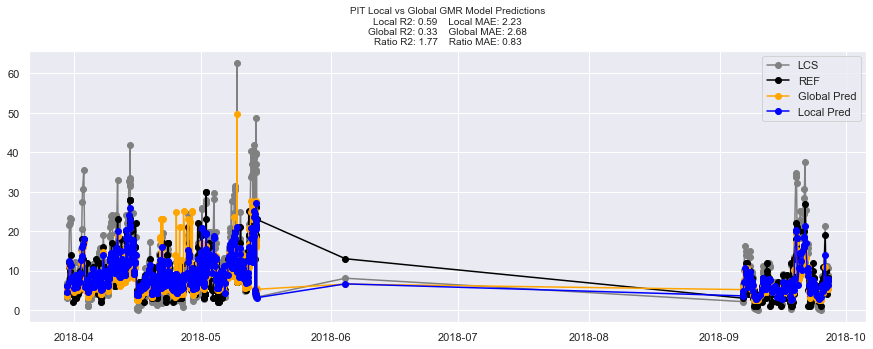

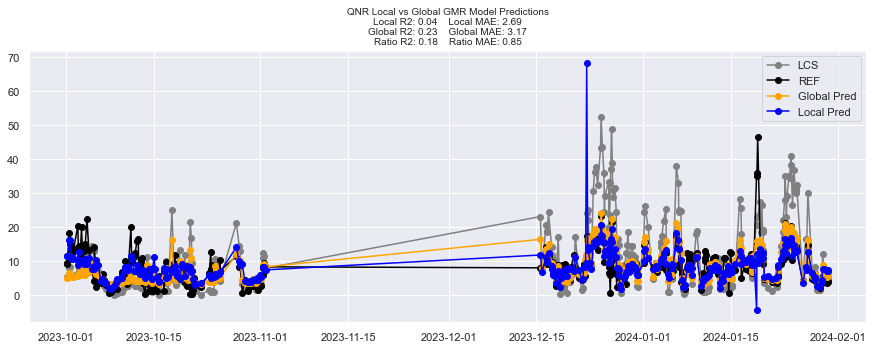

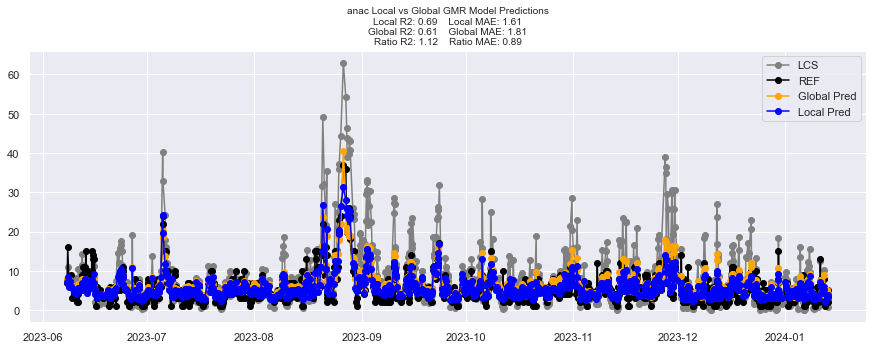

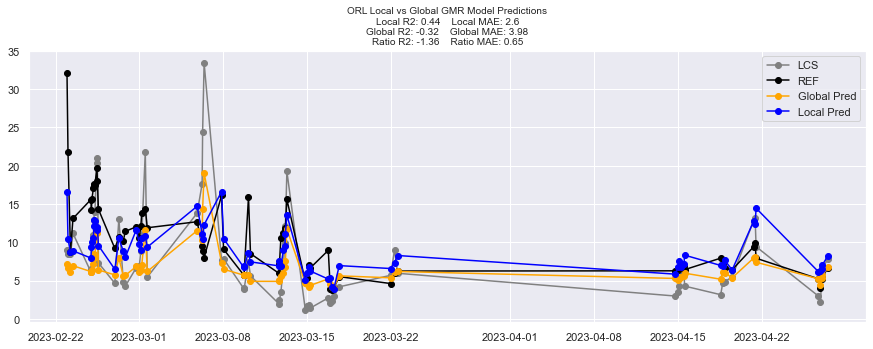

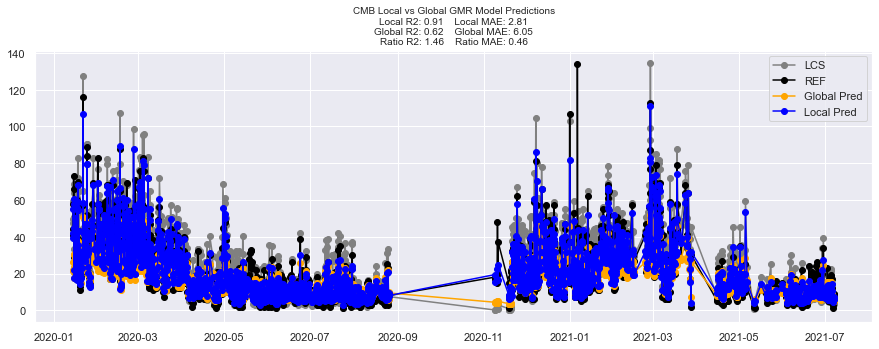

...

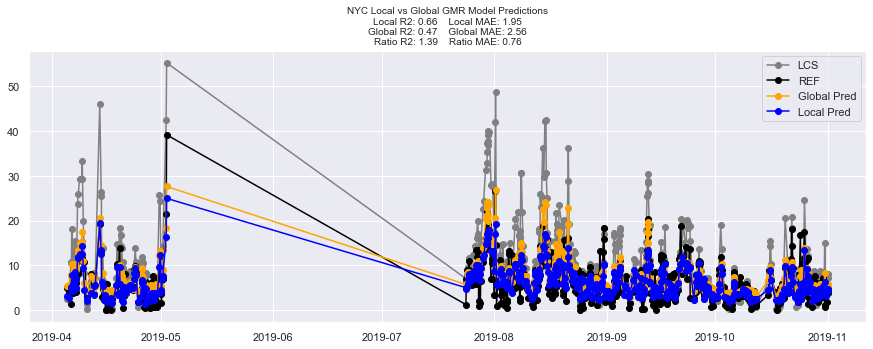

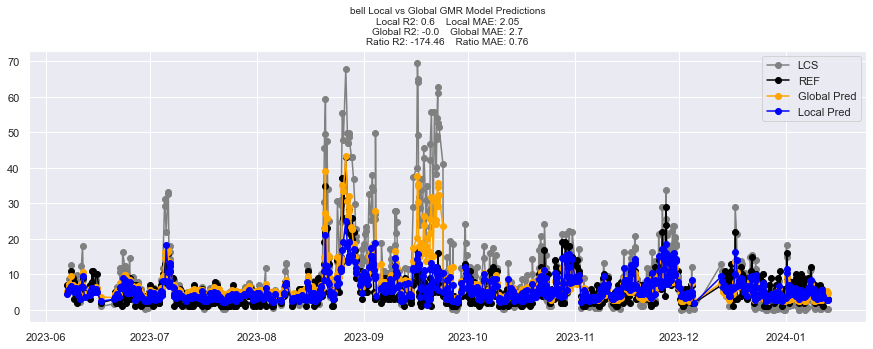

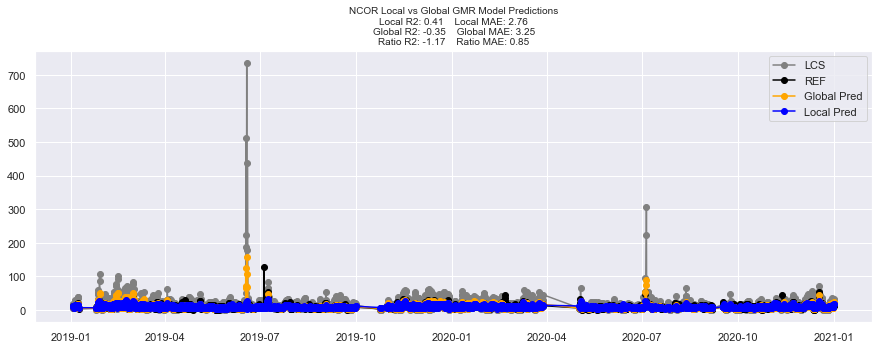

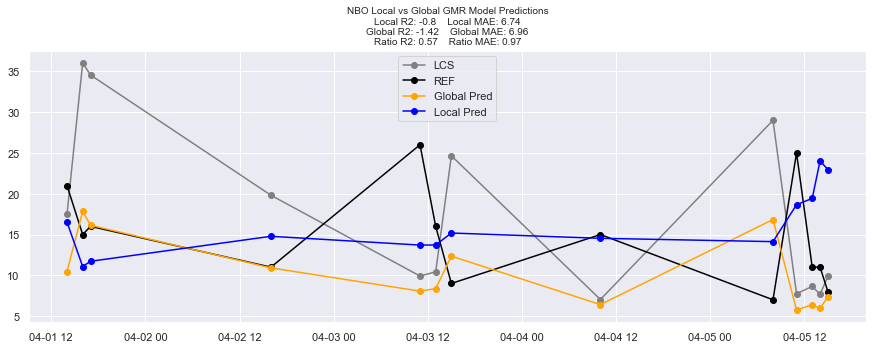

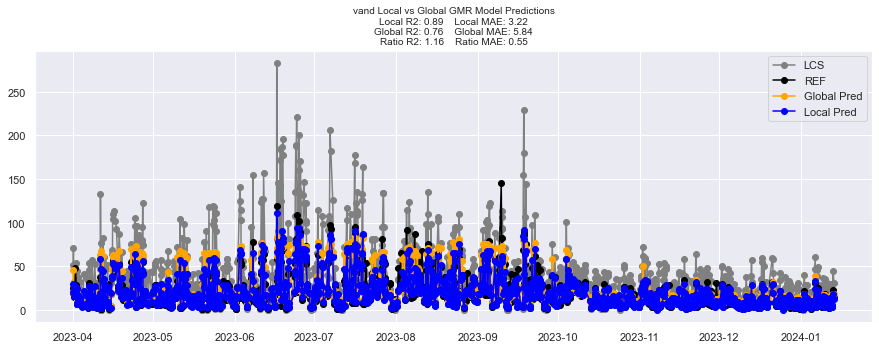

In [38]:
# train a global model, see performance of global model on all cities
# train local models for each city, see performance of local model on all cities

num_components = 7


local_vs_global_scores = pd.DataFrame(columns=['City','Local R2','Local MAE','Global R2', 'Global MAE'])




for city in data['Site Code'].unique():
    print(city)

    this_city = data[data['Site Code'] == city]
    without_this_city = data[data['Site Code'] != city]

    # global model (without the city)
    global_gmm = GMM(n_components = num_components)
    global_gmm.from_samples(without_this_city[["LCS PM2.5 Channel AB Average [ug/m3]", "LCS Avg_Temperature [oC]", "LCS Relative Humidity [%]","REF PM2.5 [ug/m3]"]].to_numpy())

    
    

    this_city.set_index('Timestamp (UTC)', inplace=True)
    this_city.index = pd.to_datetime(this_city.index)
    
    
    this_city_train, this_city_test = train_test_split(this_city, test_size = 0.2)


    this_city_train.sort_index(inplace=True)
    this_city_test.sort_index(inplace=True)
    
    #train local gmr
    local_gmm = GMM(n_components = num_components)
    local_gmm.from_samples(this_city_train[["LCS PM2.5 Channel AB Average [ug/m3]", "LCS Avg_Temperature [oC]", "LCS Relative Humidity [%]","REF PM2.5 [ug/m3]"]].to_numpy())

    # predictions from global gmr
    Y_global = global_gmm.predict(np.array([0,1,2]), this_city_test[["LCS PM2.5 Channel AB Average [ug/m3]", "LCS Avg_Temperature [oC]", "LCS Relative Humidity [%]"]].to_numpy())
    Y_local = local_gmm.predict(np.array([0,1,2]), this_city_test[["LCS PM2.5 Channel AB Average [ug/m3]", "LCS Avg_Temperature [oC]", "LCS Relative Humidity [%]"]].to_numpy())


    # scores
    global_gmr_r2_score = r2_score(this_city_test[["REF PM2.5 [ug/m3]"]].to_numpy(), Y_global)
    global_gmr_mae_score = mean_absolute_error(this_city_test[["REF PM2.5 [ug/m3]"]].to_numpy(), Y_global)
    local_gmr_r2_score = r2_score(this_city_test[["REF PM2.5 [ug/m3]"]].to_numpy(), Y_local)
    local_gmr_mae_score = mean_absolute_error(this_city_test[["REF PM2.5 [ug/m3]"]].to_numpy(), Y_local)

    local_vs_global_scores.loc[len(local_vs_global_scores.index)] = [city,global_gmr_r2_score,global_gmr_mae_score, local_gmr_r2_score, local_gmr_mae_score] 

    plt.figure(figsize=(15,5))
    plt.plot(this_city_test.index, this_city_test["LCS PM2.5 Channel AB Average [ug/m3]"], label = 'LCS', color='grey', marker='o')
    plt.plot(this_city_test.index, this_city_test["REF PM2.5 [ug/m3]"], label = 'REF', color='black', marker='o')
    plt.plot(this_city_test.index, Y_global, label = 'Global Pred', color='orange', marker='o')
    plt.plot(this_city_test.index, Y_local, label = 'Local Pred', color='blue', marker='o')
    plt.legend()
    plt.title(city + ' Local vs Global GMR Model Predictions' + '\n'+ 'Local R2: ' + str(round(local_gmr_r2_score,2)) + '    Local MAE: ' + str(round(local_gmr_mae_score,2)) + '\n' + 'Global R2: ' + str(round(global_gmr_r2_score,2)) + '    Global MAE: ' + str(round(global_gmr_mae_score,2)) + '\n' + 'Ratio R2: ' + str(round(local_gmr_r2_score/global_gmr_r2_score,2)) + '    Ratio MAE: ' + str(round(local_gmr_mae_score/global_gmr_mae_score,2)), fontsize=10 )

    
    




QNR


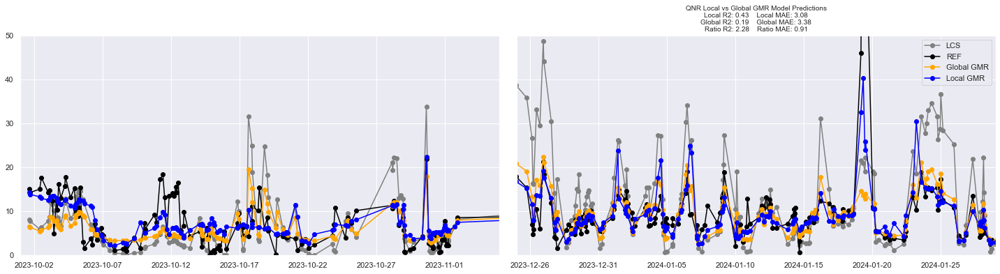

In [75]:
# train a global model, see performance of global model on all cities
# train local models for each city, see performance of local model on all cities

num_components = 7


local_vs_global_scores = pd.DataFrame(columns=['City','Local R2','Local MAE','Global R2', 'Global MAE'])




for city in data['Site Code'].unique():
    if city=='QNR':
        print(city)

        this_city = data[data['Site Code'] == city]
        without_this_city = data[data['Site Code'] != city]

        # global model (without the city)
        global_gmm = GMM(n_components = num_components)
        global_gmm.from_samples(without_this_city[["LCS PM2.5 Channel AB Average [ug/m3]", "LCS Avg_Temperature [oC]", "LCS Relative Humidity [%]","REF PM2.5 [ug/m3]"]].to_numpy())




        this_city.set_index('Timestamp (UTC)', inplace=True)
        this_city.index = pd.to_datetime(this_city.index)


        this_city_train, this_city_test = train_test_split(this_city, test_size = 0.2)


        this_city_train.sort_index(inplace=True)
        this_city_test.sort_index(inplace=True)

        #train local gmr
        local_gmm = GMM(n_components = num_components)
        local_gmm.from_samples(this_city_train[["LCS PM2.5 Channel AB Average [ug/m3]", "LCS Avg_Temperature [oC]", "LCS Relative Humidity [%]","REF PM2.5 [ug/m3]"]].to_numpy())

        # predictions from global gmr
        Y_global = global_gmm.predict(np.array([0,1,2]), this_city_test[["LCS PM2.5 Channel AB Average [ug/m3]", "LCS Avg_Temperature [oC]", "LCS Relative Humidity [%]"]].to_numpy())
        Y_local = local_gmm.predict(np.array([0,1,2]), this_city_test[["LCS PM2.5 Channel AB Average [ug/m3]", "LCS Avg_Temperature [oC]", "LCS Relative Humidity [%]"]].to_numpy())


        # scores
        global_gmr_r2_score = r2_score(this_city_test[["REF PM2.5 [ug/m3]"]].to_numpy(), Y_global)
        global_gmr_mae_score = mean_absolute_error(this_city_test[["REF PM2.5 [ug/m3]"]].to_numpy(), Y_global)
        local_gmr_r2_score = r2_score(this_city_test[["REF PM2.5 [ug/m3]"]].to_numpy(), Y_local)
        local_gmr_mae_score = mean_absolute_error(this_city_test[["REF PM2.5 [ug/m3]"]].to_numpy(), Y_local)

        local_vs_global_scores.loc[len(local_vs_global_scores.index)] = [city,global_gmr_r2_score,global_gmr_mae_score, local_gmr_r2_score, local_gmr_mae_score] 

        
        f, (ax, ax2) = plt.subplots(1, 2, sharey=True, figsize=(20,5))

        

        
        
        ax.plot(this_city_test.index, this_city_test["LCS PM2.5 Channel AB Average [ug/m3]"], label = 'LCS', color='grey', marker='o')
        ax.plot(this_city_test.index, this_city_test["REF PM2.5 [ug/m3]"], label = 'REF', color='black', marker='o')
        ax.plot(this_city_test.index, Y_global, label = 'Global GMR', color='orange', marker='o')
        ax.plot(this_city_test.index, Y_local, label = 'Local GMR', color='blue', marker='o')
        
        ax2.plot(this_city_test.index, this_city_test["LCS PM2.5 Channel AB Average [ug/m3]"], label = 'LCS', color='grey', marker='o')
        ax2.plot(this_city_test.index, this_city_test["REF PM2.5 [ug/m3]"], label = 'REF', color='black', marker='o')
        ax2.plot(this_city_test.index, Y_global, label = 'Global GMR', color='orange', marker='o')
        ax2.plot(this_city_test.index, Y_local, label = 'Local GMR', color='blue', marker='o')
        
        # zoom-in / limit the view to different portions of the data
        ax.set_xlim('2023-10-01','2023-11-05')  # outliers only
        ax2.set_xlim('2023-12-25','2024-01-29')  # most of the data
        
        ax.set_ylim(0,50)  # outliers only
        ax2.set_ylim(0,50)  # most of the data
        
        ax.xaxis.set_major_locator(mdates.DayLocator(interval=5))
        ax.xaxis.set_major_formatter(DateFormatter('%Y-%m-%d'))
        
        ax2.xaxis.set_major_locator(mdates.DayLocator(interval=5))
        ax2.xaxis.set_major_formatter(DateFormatter('%Y-%m-%d'))
        
        f.tight_layout()
        
        plt.legend()
        plt.title(city + ' Local vs Global GMR Model Predictions' + '\n'+ 'Local R2: ' + str(round(local_gmr_r2_score,2)) + '    Local MAE: ' + str(round(local_gmr_mae_score,2)) + '\n' + 'Global R2: ' + str(round(global_gmr_r2_score,2)) + '    Global MAE: ' + str(round(global_gmr_mae_score,2)) + '\n' + 'Ratio R2: ' + str(round(local_gmr_r2_score/global_gmr_r2_score,2)) + '    Ratio MAE: ' + str(round(local_gmr_mae_score/global_gmr_mae_score,2)), fontsize=10 )

        





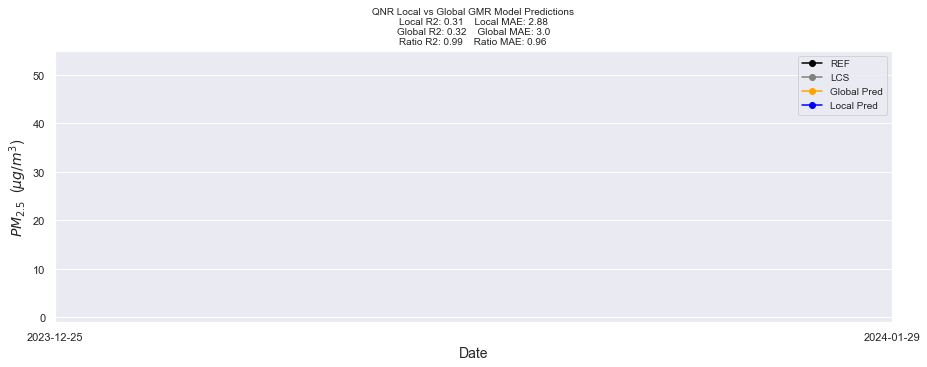

In [54]:
plt.figure(figsize=(15,5))
plt.plot(this_city_test.index, this_city_test["REF PM2.5 [ug/m3]"], label = 'REF', color='black', marker='o')
plt.plot(this_city_test.index, this_city_test["LCS PM2.5 Channel AB Average [ug/m3]"], label = 'LCS', color='grey', marker='o')
plt.plot(this_city_test.index, Y_global, label = 'Global Pred', color='orange', marker='o')
plt.plot(this_city_test.index, Y_local, label = 'Local Pred', color='blue', marker='o')
plt.legend()
plt.xlim('2023-12-25','2024-01-29')
plt.ylim(-1, 55)
plt.title(city + ' Local vs Global GMR Model Predictions' + '\n'+ 'Local R2: ' + str(round(local_gmr_r2_score,2)) + '    Local MAE: ' + str(round(local_gmr_mae_score,2)) + '\n' + 'Global R2: ' + str(round(global_gmr_r2_score,2)) + '    Global MAE: ' + str(round(global_gmr_mae_score,2)) + '\n' + 'Ratio R2: ' + str(round(local_gmr_r2_score/global_gmr_r2_score,2)) + '    Ratio MAE: ' + str(round(local_gmr_mae_score/global_gmr_mae_score,2)), fontsize=10 )
plt.xlabel('Date',fontsize=14)
plt.ylabel('$PM_{2.5}$' + '  ' + '($µg/m^3$)',fontsize=14)
plt.xticks(fontsize=11)
plt.yticks(fontsize=11)
plt.legend(fontsize=10)

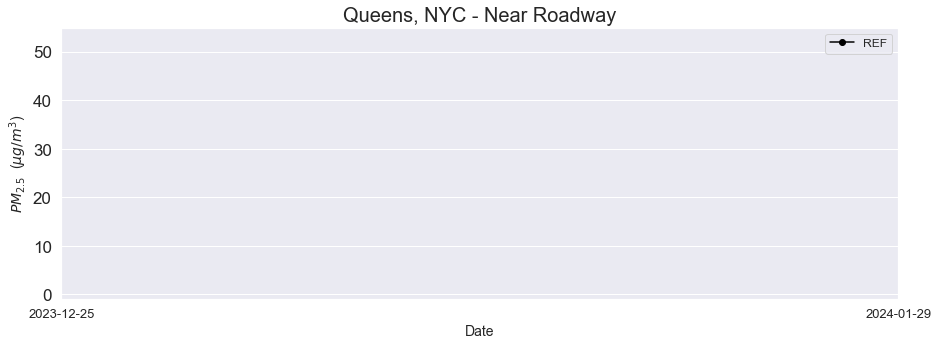

In [55]:
plt.figure(figsize=(15,5))
plt.plot(this_city_test.index, this_city_test["REF PM2.5 [ug/m3]"], label = 'REF', color='black', marker='o')
#plt.plot(this_city_test.index, this_city_test["LCS PM2.5 Channel AB Average [ug/m3]"], label = 'LCS', color='grey', marker='o')
#plt.plot(this_city_test.index, Y_global, label = 'Global Pred', color='orange', marker='o')
#plt.plot(this_city_test.index, Y_local, label = 'Local Pred', color='blue', marker='o')
plt.legend()
plt.xlim('2023-12-25','2024-01-29')
plt.ylim(-1, 55)
#plt.title(city + ' Local vs Global GMR Model Predictions' + '\n'+ 'Local R2: ' + str(round(local_gmr_r2_score,2)) + '    Local MAE: ' + str(round(local_gmr_mae_score,2)) + '\n' + 'Global R2: ' + str(round(global_gmr_r2_score,2)) + '    Global MAE: ' + str(round(global_gmr_mae_score,2)) + '\n' + 'Ratio R2: ' + str(round(local_gmr_r2_score/global_gmr_r2_score,2)) + '    Ratio MAE: ' + str(round(local_gmr_mae_score/global_gmr_mae_score,2)), fontsize=10 )
plt.title('Queens, NYC - Near Roadway',fontsize=20)
plt.xlabel('Date',fontsize=14)
plt.ylabel('$PM_{2.5}$' + '  ' + '($µg/m^3$)',fontsize=14)
plt.xticks(fontsize=13)
plt.yticks(fontsize=17)
plt.legend(fontsize=12)

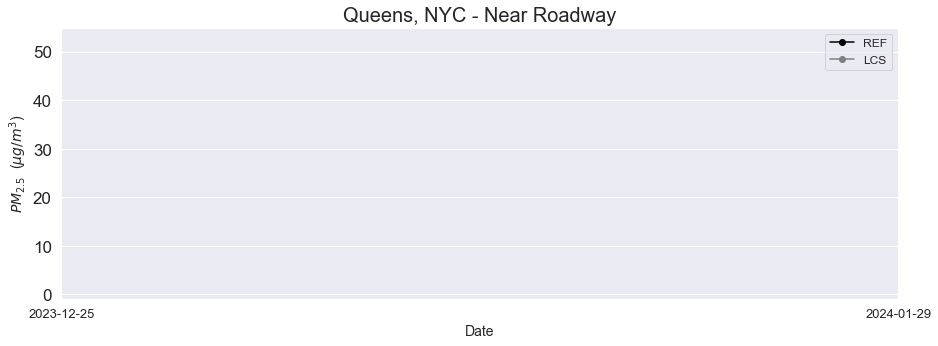

In [56]:
plt.figure(figsize=(15,5))
plt.plot(this_city_test.index, this_city_test["REF PM2.5 [ug/m3]"], label = 'REF', color='black', marker='o')
plt.plot(this_city_test.index, this_city_test["LCS PM2.5 Channel AB Average [ug/m3]"], label = 'LCS', color='grey', marker='o')
#plt.plot(this_city_test.index, Y_global, label = 'Global Pred', color='orange', marker='o')
#plt.plot(this_city_test.index, Y_local, label = 'Local Pred', color='blue', marker='o')
plt.legend()
plt.xlim('2023-12-25','2024-01-29')
plt.ylim(-1, 55)
plt.title('Queens, NYC - Near Roadway',fontsize=20)
plt.xlabel('Date',fontsize=14)
plt.ylabel('$PM_{2.5}$' + '  ' + '($µg/m^3$)',fontsize=14)
plt.xticks(fontsize=13)
plt.yticks(fontsize=17)
plt.legend(fontsize=12)

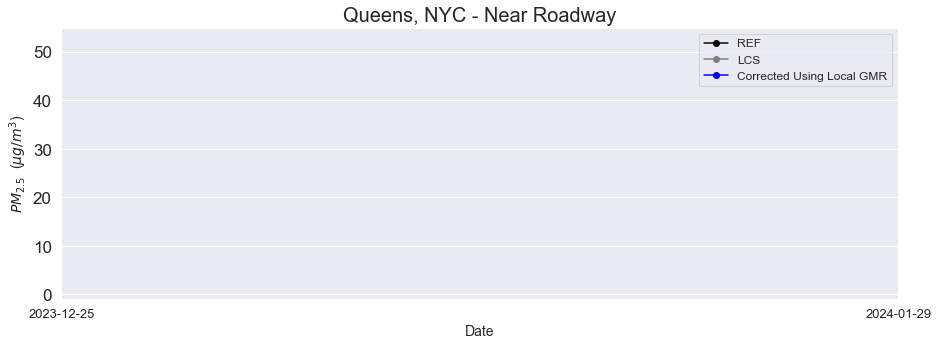

In [57]:
plt.figure(figsize=(15,5))
plt.plot(this_city_test.index, this_city_test["REF PM2.5 [ug/m3]"], label = 'REF', color='black', marker='o')
plt.plot(this_city_test.index, this_city_test["LCS PM2.5 Channel AB Average [ug/m3]"], label = 'LCS', color='grey', marker='o')
#plt.plot(this_city_test.index, Y_global, label = 'Global Pred', color='orange', marker='o')
plt.plot(this_city_test.index, Y_local, label = 'Corrected Using Local GMR', color='blue', marker='o')
plt.legend()
plt.xlim('2023-12-25','2024-01-29')
plt.ylim(-1, 55)
plt.title('Queens, NYC - Near Roadway',fontsize=20)
plt.xlabel('Date',fontsize=14)
plt.ylabel('$PM_{2.5}$' + '  ' + '($µg/m^3$)',fontsize=14)
plt.xticks(fontsize=13)
plt.yticks(fontsize=17)
plt.legend(fontsize=12)

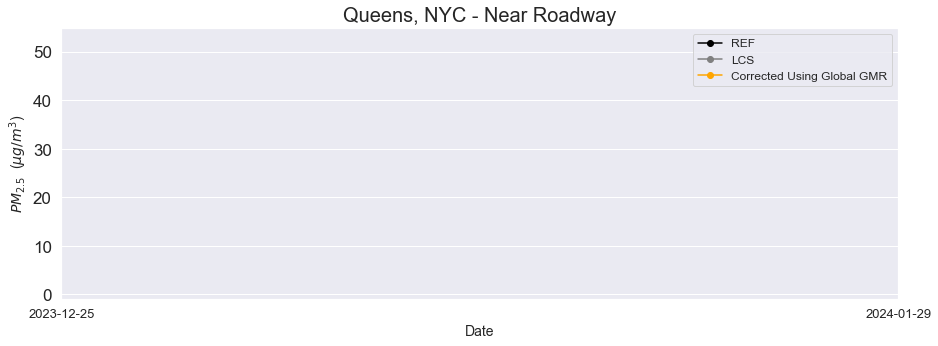

In [58]:
plt.figure(figsize=(15,5))
plt.plot(this_city_test.index, this_city_test["REF PM2.5 [ug/m3]"], label = 'REF', color='black', marker='o')
plt.plot(this_city_test.index, this_city_test["LCS PM2.5 Channel AB Average [ug/m3]"], label = 'LCS', color='grey', marker='o')
plt.plot(this_city_test.index, Y_global, label = 'Corrected Using Global GMR', color='orange', marker='o')
#plt.plot(this_city_test.index, Y_local, label = 'Colocation GMR Prediction', color='blue', marker='o')
plt.legend()
plt.xlim('2023-12-25','2024-01-29')
plt.ylim(-1, 55)
plt.title('Queens, NYC - Near Roadway',fontsize=20)
plt.xlabel('Date',fontsize=14)
plt.ylabel('$PM_{2.5}$' + '  ' + '($µg/m^3$)',fontsize=14)
plt.xticks(fontsize=13)
plt.yticks(fontsize=17)
plt.legend(fontsize=12)

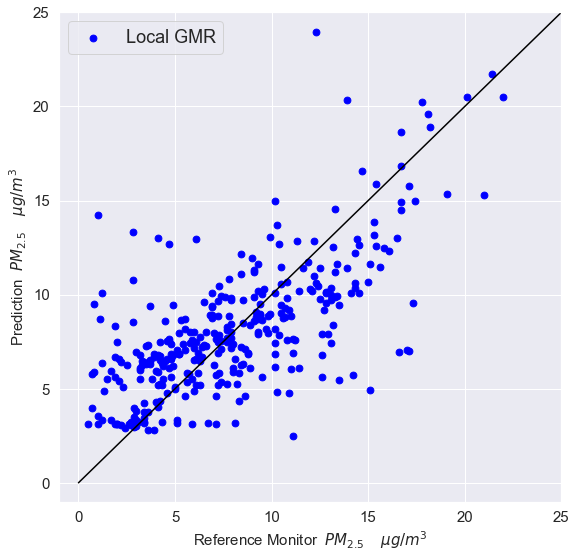

In [59]:
plt.figure(figsize=(9,9))
#plt.scatter(this_city_test["REF PM2.5 [ug/m3]"], Y_global, color='orange', label='Correction B',s=46)
plt.scatter(this_city_test["REF PM2.5 [ug/m3]"], Y_local, color='blue', label='Local GMR',s=46)
#plt.scatter(this_city_test["REF PM2.5 [ug/m3]"], this_city_test["LCS PM2.5 Channel AB Average [ug/m3]"], color='grey', label='LCS')
plt.xlabel('Reference Monitor ' + ' $PM_{2.5}$  ' + '  $µg/m^3$',fontsize=15)
plt.ylabel('Prediction ' + ' $PM_{2.5}$  ' + '  $µg/m^3$',fontsize=15)
plt.plot(np.arange(0,60),np.arange(0,60), color='black')
plt.xlim(-1,25)
plt.ylim(-1,25)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.legend(fontsize=18)

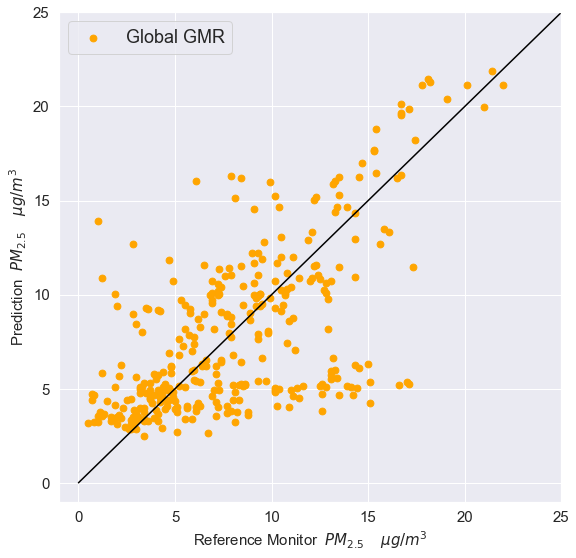

In [60]:
plt.figure(figsize=(9,9))
plt.scatter(this_city_test["REF PM2.5 [ug/m3]"], Y_global, color='orange', label='Global GMR',s=46)
#plt.scatter(this_city_test["REF PM2.5 [ug/m3]"], Y_local, color='blue', label='Correction A',s=46)
#plt.scatter(this_city_test["REF PM2.5 [ug/m3]"], this_city_test["LCS PM2.5 Channel AB Average [ug/m3]"], color='grey', label='LCS')
plt.xlabel('Reference Monitor ' + ' $PM_{2.5}$  ' + '  $µg/m^3$',fontsize=15)
plt.ylabel('Prediction ' + ' $PM_{2.5}$  ' + '  $µg/m^3$',fontsize=15)
plt.plot(np.arange(0,60),np.arange(0,60), color='black')
plt.xlim(-1,25)
plt.ylim(-1,25)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.legend(fontsize=18)

In [ ]:
# train a global model, see performance of global model on all cities
# train local models for each city, see performance of local model on all cities

num_components = 7


local_vs_global_scores = pd.DataFrame(columns=['City','Local R2','Local MAE','Global R2', 'Global MAE'])




for city in data['Site Code'].unique():
    print(city)

    this_city = data[data['Site Code'] == city]
    without_this_city = data[data['Site Code'] != city]

    # global model (without the city)
    global_gmm = GMM(n_components = num_components)
    global_gmm.from_samples(without_this_city[["LCS PM2.5 Channel AB Average [ug/m3]", "LCS Avg_Temperature [oC]", "LCS Relative Humidity [%]","REF PM2.5 [ug/m3]"]].to_numpy())

    
    

    this_city.set_index('Timestamp (UTC)', inplace=True)
    this_city.index = pd.to_datetime(this_city.index)
    
    
    this_city_train, this_city_test = train_test_split(this_city, test_size = 0.2)


    this_city_train.sort_index(inplace=True)
    this_city_test.sort_index(inplace=True)
    
    #train local gmr
    local_gmm = GMM(n_components = num_components)
    local_gmm.from_samples(this_city_train[["LCS PM2.5 Channel AB Average [ug/m3]", "LCS Avg_Temperature [oC]", "LCS Relative Humidity [%]","REF PM2.5 [ug/m3]"]].to_numpy())

    # predictions from global gmr
    Y_global = global_gmm.predict(np.array([0,1,2]), this_city_test[["LCS PM2.5 Channel AB Average [ug/m3]", "LCS Avg_Temperature [oC]", "LCS Relative Humidity [%]"]].to_numpy())
    Y_local = local_gmm.predict(np.array([0,1,2]), this_city_test[["LCS PM2.5 Channel AB Average [ug/m3]", "LCS Avg_Temperature [oC]", "LCS Relative Humidity [%]"]].to_numpy())


    # scores
    global_gmr_r2_score = r2_score(this_city_test[["REF PM2.5 [ug/m3]"]].to_numpy(), Y_global)
    global_gmr_mae_score = mean_absolute_error(this_city_test[["REF PM2.5 [ug/m3]"]].to_numpy(), Y_global)
    local_gmr_r2_score = r2_score(this_city_test[["REF PM2.5 [ug/m3]"]].to_numpy(), Y_local)
    local_gmr_mae_score = mean_absolute_error(this_city_test[["REF PM2.5 [ug/m3]"]].to_numpy(), Y_local)

    local_vs_global_scores.loc[len(local_vs_global_scores.index)] = [city,global_gmr_r2_score,global_gmr_mae_score, local_gmr_r2_score, local_gmr_mae_score] 

#     plt.figure(figsize=(15,5))
#     plt.plot(this_city_test.index, this_city_test["LCS PM2.5 Channel AB Average [ug/m3]"], label = 'LCS', color='grey', marker='o')
#     plt.plot(this_city_test.index, this_city_test["REF PM2.5 [ug/m3]"], label = 'REF', color='black', marker='o')
#     plt.plot(this_city_test.index, Y_global, label = 'Global Pred', color='orange', marker='o')
#     plt.plot(this_city_test.index, Y_local, label = 'Local Pred', color='blue', marker='o')
#     plt.legend()
#     plt.title(city + ' Local vs Global GMR Model Predictions' + '\n'+ 'Local R2: ' + str(round(local_gmr_r2_score,2)) + '    Local MAE: ' + str(round(local_gmr_mae_score,2)) + '\n' + 'Global R2: ' + str(round(global_gmr_r2_score,2)) + '    Global MAE: ' + str(round(global_gmr_mae_score,2)) + '\n' + 'Ratio R2: ' + str(round(local_gmr_r2_score/global_gmr_r2_score,2)) + '    Ratio MAE: ' + str(round(local_gmr_mae_score/global_gmr_mae_score,2)), fontsize=10 )

    
    




In [ ]:
local_vs_global_scores

In [ ]:
local_vs_global_scores_clean = local_vs_global_scores[local_vs_global_scores['City']!='NBO']

lgs3 = pd.pivot_table(local_vs_global_scores, values=['Local MAE', 'Global MAE'], index=['City'], aggfunc=np.mean)
fig = go.Figure()

fig.add_trace(go.Bar(x=lgs3.index, y=lgs3["Local MAE"], name='Local MAE',marker_color='Blue'))
fig.add_trace(go.Bar(x=lgs3.index, y=lgs3["Global MAE"], name='Global MAE',marker_color='Orange'))
fig.update_layout(yaxis_range=[0,6],yaxis_title='Mean Absolute Error' + ' ' + '$µg/m^3$', width=1200, height=400, xaxis_title='Site')
fig.show()

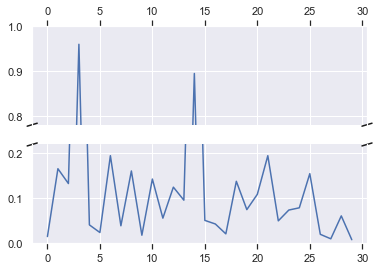

In [62]:
# 30 points between [0, 0.2) originally made using np.random.rand(30)*.2
pts = np.array([
    0.015, 0.166, 0.133, 0.159, 0.041, 0.024, 0.195, 0.039, 0.161, 0.018,
    0.143, 0.056, 0.125, 0.096, 0.094, 0.051, 0.043, 0.021, 0.138, 0.075,
    0.109, 0.195, 0.050, 0.074, 0.079, 0.155, 0.020, 0.010, 0.061, 0.008])

# Now let's make two outlier points which are far away from everything.
pts[[3, 14]] += .8

# If we were to simply plot pts, we'd lose most of the interesting
# details due to the outliers. So let's 'break' or 'cut-out' the y-axis
# into two portions - use the top (ax) for the outliers, and the bottom
# (ax2) for the details of the majority of our data
f, (ax, ax2) = plt.subplots(2, 1, sharex=True)

# plot the same data on both axes
ax.plot(pts)
ax2.plot(pts)

# zoom-in / limit the view to different portions of the data
ax.set_ylim(.78, 1.)  # outliers only
ax2.set_ylim(0, .22)  # most of the data

# hide the spines between ax and ax2
ax.spines['bottom'].set_visible(False)
ax2.spines['top'].set_visible(False)
ax.xaxis.tick_top()
ax.tick_params(labeltop='off')  # don't put tick labels at the top
ax2.xaxis.tick_bottom()

# This looks pretty good, and was fairly painless, but you can get that
# cut-out diagonal lines look with just a bit more work. The important
# thing to know here is that in axes coordinates, which are always
# between 0-1, spine endpoints are at these locations (0,0), (0,1),
# (1,0), and (1,1).  Thus, we just need to put the diagonals in the
# appropriate corners of each of our axes, and so long as we use the
# right transform and disable clipping.

d = .015  # how big to make the diagonal lines in axes coordinates
# arguments to pass to plot, just so we don't keep repeating them
kwargs = dict(transform=ax.transAxes, color='k', clip_on=False)
ax.plot((-d, +d), (-d, +d), **kwargs)        # top-left diagonal
ax.plot((1 - d, 1 + d), (-d, +d), **kwargs)  # top-right diagonal

kwargs.update(transform=ax2.transAxes)  # switch to the bottom axes
ax2.plot((-d, +d), (1 - d, 1 + d), **kwargs)  # bottom-left diagonal
ax2.plot((1 - d, 1 + d), (1 - d, 1 + d), **kwargs)  # bottom-right diagonal

# What's cool about this is that now if we vary the distance between
# ax and ax2 via f.subplots_adjust(hspace=...) or plt.subplot_tool(),
# the diagonal lines will move accordingly, and stay right at the tips
# of the spines they are 'breaking'

plt.show()